In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

In [2]:
df = pd.read_csv('S_Parameter_Table_1v1.csv', header=None)

df.columns = ['h', 'w', 'Freq', 'S11']

X = df.drop('S11', axis=1).copy()
y = df['S11'].copy()

X_encoded=pd.get_dummies(X, columns=['h', 'w', 'Freq'])

y_db = y <= -10
y_nodb = y > -10
y[y_db] = 1
y[y_nodb]=0

rs=28 #42 originally

In [3]:
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y, random_state=rs)

clf_dt = DecisionTreeClassifier(random_state=rs)
clf_dt = clf_dt.fit(X_train, y_train)



In [4]:

plt.figure(figsize=(400, 200))
plot_tree(clf_dt, 
          filled=True,
          rounded=True,
          class_names=["Non-Func", "Func"],
          feature_names=X_encoded.columns.tolist());


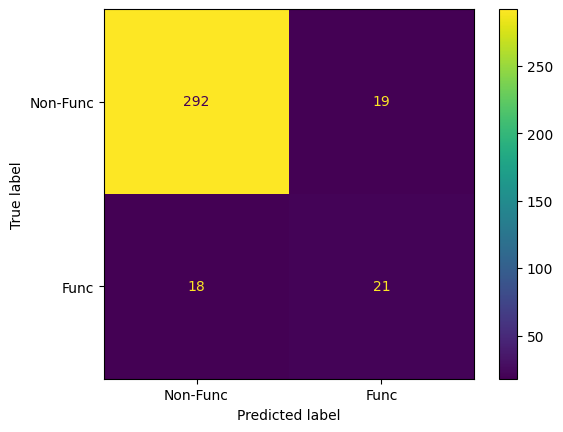

In [4]:

predictions = clf_dt.predict(X_test)

cm = confusion_matrix(y_test, predictions)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels=["Non-Func", "Func"])
disp.plot()

In [6]:

path = clf_dt.cost_complexity_pruning_path(X_train, y_train)
ccp_alphas = path.ccp_alphas
ccp_alphas = ccp_alphas[:-1]

clf_dts = []

In [7]:

for ccp_alpha in ccp_alphas:
    clf_dt = DecisionTreeClassifier(random_state=0, ccp_alpha=ccp_alpha)
    clf_dt.fit(X_train, y_train)
    clf_dts.append(clf_dt)
    

In [8]:

train_scores = [clf_dt.score(X_train, y_train) for clf_dt in clf_dts]
test_scores = [clf_dt.score(X_test, y_test) for clf_dt in clf_dts]


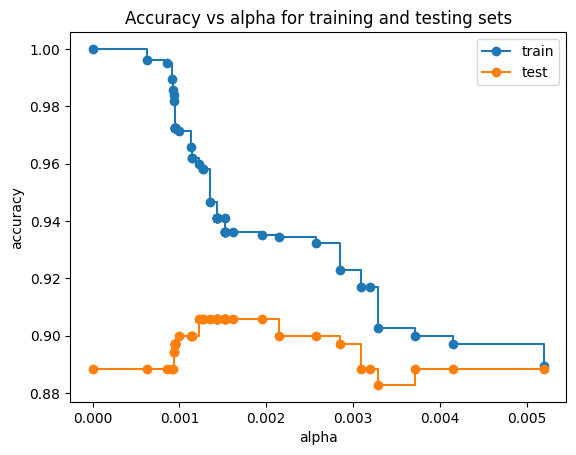

In [9]:

fig, ax = plt.subplots()
ax.set_xlabel("alpha")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs alpha for training and testing sets")
ax.plot(ccp_alphas, train_scores, marker='o', label="train", drawstyle="steps-post")
ax.plot(ccp_alphas, test_scores, marker='o', label="test", drawstyle="steps-post")
ax.legend()
plt.show()



<Axes: xlabel='alpha'>

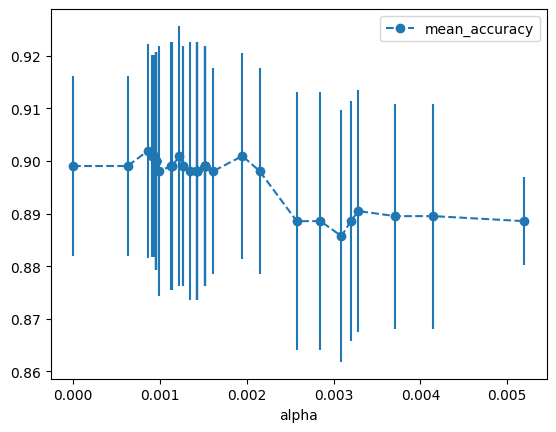

In [10]:

alpha_loop_values = []

for ccp_alpha in ccp_alphas:
    clf_dt = DecisionTreeClassifier(random_state=0, ccp_alpha=ccp_alpha)
    scores = cross_val_score(clf_dt, X_train, y_train, cv=5)
    alpha_loop_values.append([ccp_alpha, np.mean(scores), np.std(scores)])
    
alpha_results = pd.DataFrame(alpha_loop_values, columns=['alpha', 'mean_accuracy', 'std'])

alpha_results.plot(x='alpha', y='mean_accuracy', yerr='std', marker='o', linestyle='--')


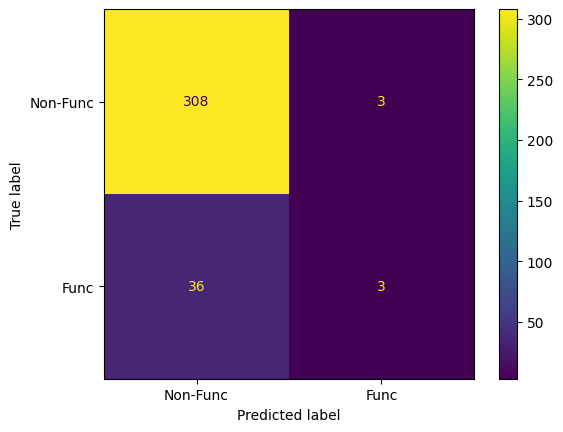

In [12]:

clf_dt_pruned = DecisionTreeClassifier(random_state=rs, ccp_alpha=0.00311362)
clf_dt_pruned = clf_dt_pruned.fit(X_train, y_train)
predictions = clf_dt_pruned.predict(X_test)

cm = confusion_matrix(y_test, predictions)
disp = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels=["Non-Func", "Func"])
disp.plot()

plt.figure(figsize=(400, 200))
plot_tree(clf_dt_pruned, 
          filled=True,
          rounded=True,
          class_names=["Non-Func", "Func"],
          feature_names=X_encoded.columns.tolist());

